In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip /content/drive/MyDrive/26-08-2024.zip -d /content/dataset/

Archive:  /content/drive/MyDrive/26-08-2024.zip
   creating: /content/dataset/26-08-2024/
  inflating: /content/dataset/26-08-2024/data.yaml  
  inflating: /content/dataset/26-08-2024/README.dataset.txt  
  inflating: /content/dataset/26-08-2024/README.roboflow.txt  
   creating: /content/dataset/26-08-2024/runs/
   creating: /content/dataset/26-08-2024/runs/detect/
   creating: /content/dataset/26-08-2024/runs/detect/train/
  inflating: /content/dataset/26-08-2024/runs/detect/train/args.yaml  
  inflating: /content/dataset/26-08-2024/runs/detect/train/confusion_matrix.png  
  inflating: /content/dataset/26-08-2024/runs/detect/train/confusion_matrix_normalized.png  
  inflating: /content/dataset/26-08-2024/runs/detect/train/events.out.tfevents.1724659654.casr-4-Precision-3591.92471.0  
  inflating: /content/dataset/26-08-2024/runs/detect/train/F1_curve.png  
  inflating: /content/dataset/26-08-2024/runs/detect/train/labels.jpg  
  inflating: /content/dataset/26-08-2024/runs/detect/trai

In [3]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.8/41.8 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 872.3/872.3 kB 26.9 MB/s eta 0:00:00


In [4]:
import yaml

# Define the content you want to write to the YAML file
data = {
    'path': '/content/dataset/26-08-2024/data.yaml',
    'train': '/content/dataset/26-08-2024/train/images',
    'val': '/content/dataset/26-08-2024/valid/images',
    'test': '/content/dataset/26-08-2024/test/images',
    'names': {
        0: 'person'
    }
}

# Path to your YAML file
yaml_file_path = '/content/dataset/26-08-2024/data.yaml'

# Write the content to the YAML file
with open(yaml_file_path, 'w') as file:
    yaml.dump(data, file, default_flow_style=False)

print(f"YAML file '{yaml_file_path}' has been overwritten successfully.")


YAML file '/content/dataset/26-08-2024/data.yaml' has been overwritten successfully.


In [ ]:
from ultralytics import YOLO

# Load the YOLOv8 model
model = YOLO('yolov8n.pt')  # Choose a model variant like 'yolov8n.pt', 'yolov8s.pt', etc.

# Train the model using the data.yaml configuration
model.train(data='/content/dataset/26-08-2024/data.yaml', epochs=50, imgsz=640)



0: 640x640 2 persons, 15.6ms
Speed: 2.4ms preprocess, 15.6ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


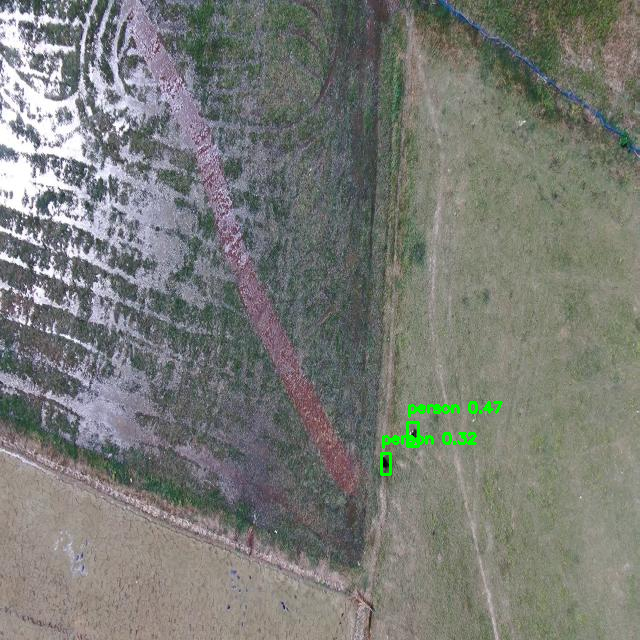

False

In [7]:
from ultralytics import YOLO
from google.colab.patches import cv2_imshow
import cv2
import torch

# Load the YOLOv8 model
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Load a test image
image_path = '/content/dataset/26-08-2024/test/images/fsi122_jpg.rf.522dadebf50d11555d7317bd3f870330.jpg'  # Replace with your image path
image = cv2.imread(image_path)

# Perform inference
results = model(image)

# Process and display the results
for result in results:
    boxes = result.boxes
    for box in boxes:
        # Get the coordinates of the bounding box
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Get the label and confidence score
        label = model.names[int(box.cls)]
        confidence = box.conf[0]

        # Display label and confidence on the image
        cv2.putText(image, f'{label} {confidence:.2f}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display the image
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Save the result
cv2.imwrite('output/output.jpg', image)

# **Image Input**


image 1/1 /content/dataset/26-08-2024/test/images/fsi309_jpg.rf.21abe835cea2050dfa922cdc646fdd5d.jpg: 640x640 6 persons, 7.4ms
Speed: 1.6ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi309_jpg.rf.21abe835cea2050dfa922cdc646fdd5d.jpg


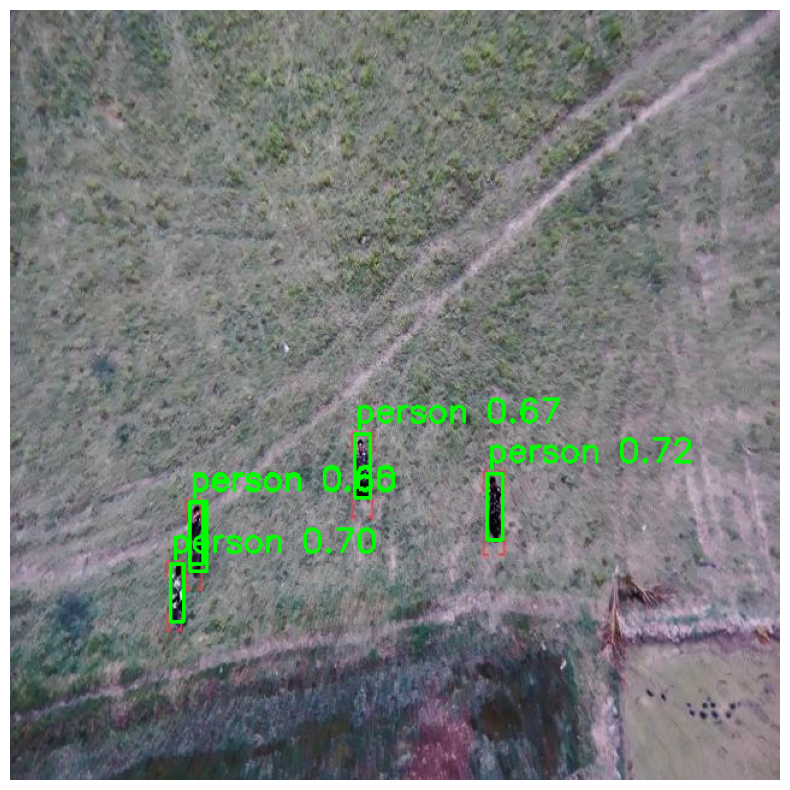


image 1/1 /content/dataset/26-08-2024/test/images/fsi34_jpg.rf.28072e8ea7a94a4bad861396d681a5d4.jpg: 640x640 5 persons, 8.8ms
Speed: 2.2ms preprocess, 8.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi34_jpg.rf.28072e8ea7a94a4bad861396d681a5d4.jpg


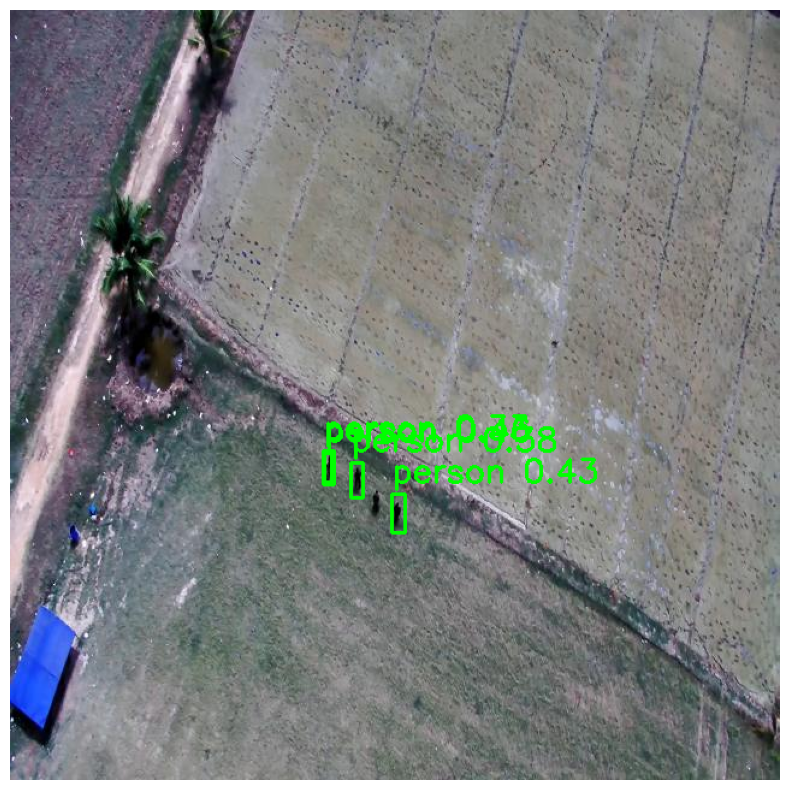


image 1/1 /content/dataset/26-08-2024/test/images/fsi16_jpg.rf.15091c43aa4778f6353a23f239441244.jpg: 640x640 4 persons, 9.6ms
Speed: 2.2ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi16_jpg.rf.15091c43aa4778f6353a23f239441244.jpg


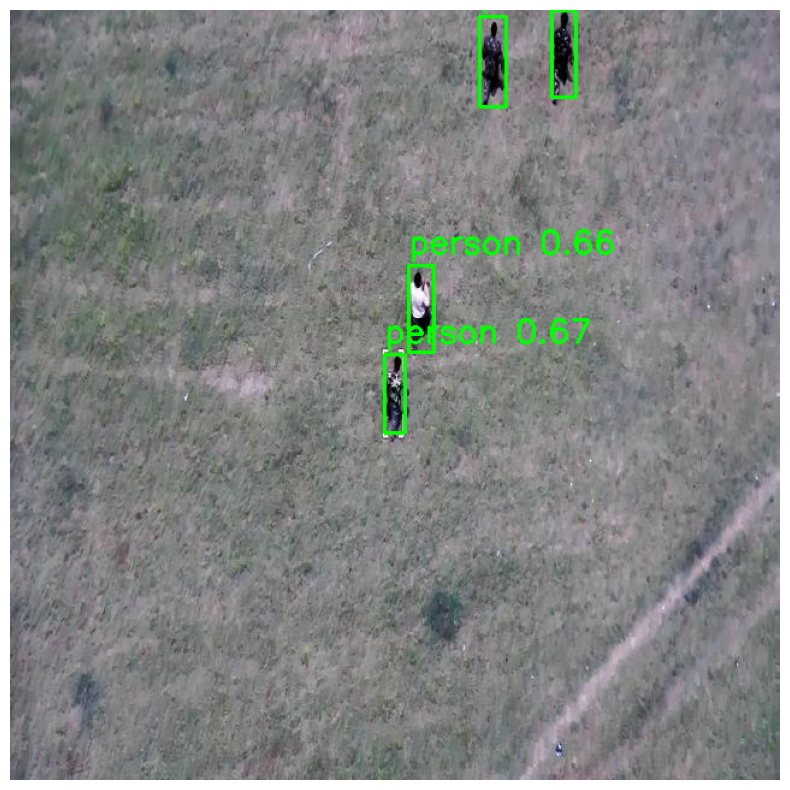


image 1/1 /content/dataset/26-08-2024/test/images/fsi59_jpg.rf.f5691b0356a167c62253829e0385cc78.jpg: 640x640 1 person, 14.8ms
Speed: 2.4ms preprocess, 14.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi59_jpg.rf.f5691b0356a167c62253829e0385cc78.jpg


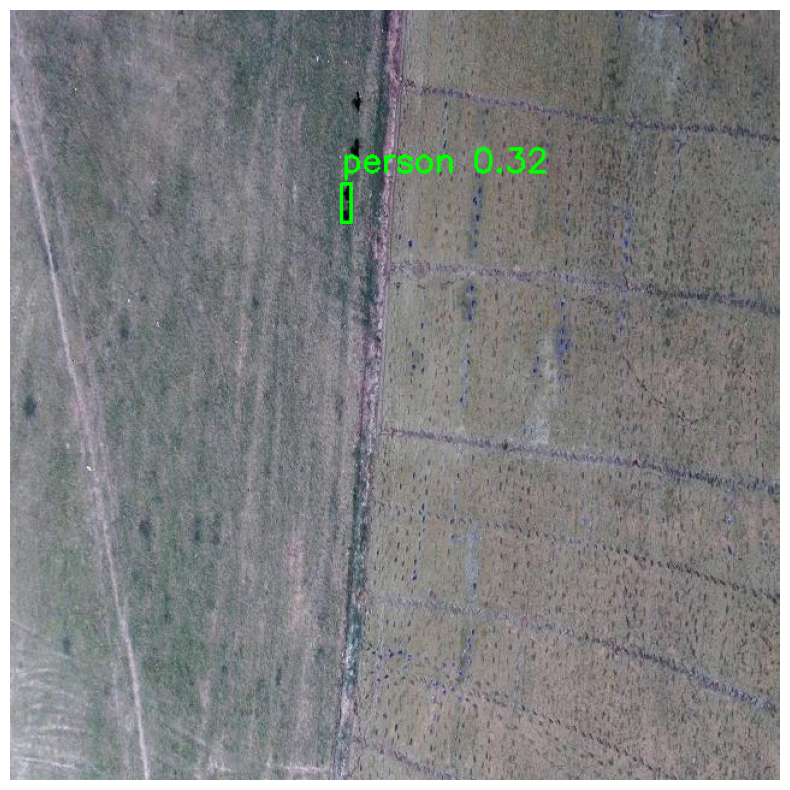


image 1/1 /content/dataset/26-08-2024/test/images/fsi180_jpg.rf.72e5999dbe50544d93de74fbc335a14e.jpg: 640x640 4 persons, 9.5ms
Speed: 2.2ms preprocess, 9.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi180_jpg.rf.72e5999dbe50544d93de74fbc335a14e.jpg


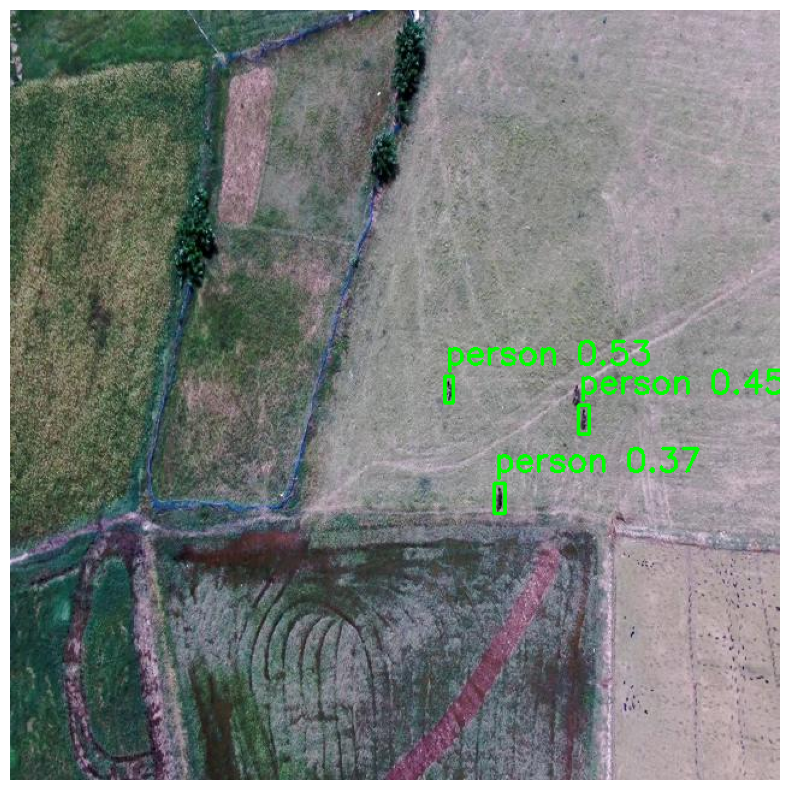


image 1/1 /content/dataset/26-08-2024/test/images/fsi236_jpg.rf.78ff3c7b7accb3406993bf6e828453e4.jpg: 640x640 4 persons, 13.0ms
Speed: 2.2ms preprocess, 13.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi236_jpg.rf.78ff3c7b7accb3406993bf6e828453e4.jpg


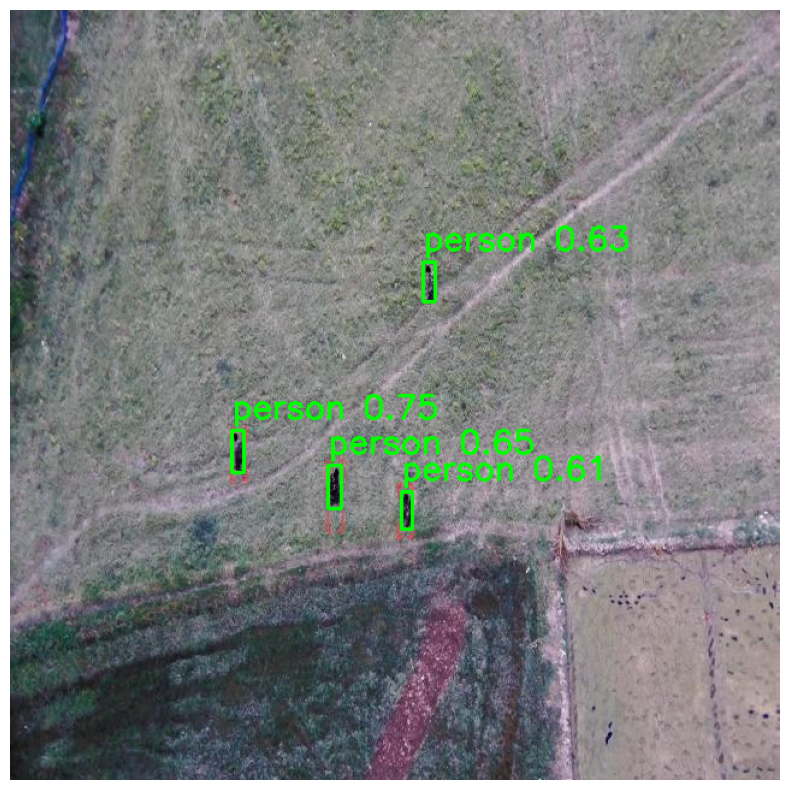


image 1/1 /content/dataset/26-08-2024/test/images/fsi245_jpg.rf.66e18d15094f2516820027feb1bbe8e6.jpg: 640x640 4 persons, 9.4ms
Speed: 2.3ms preprocess, 9.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi245_jpg.rf.66e18d15094f2516820027feb1bbe8e6.jpg


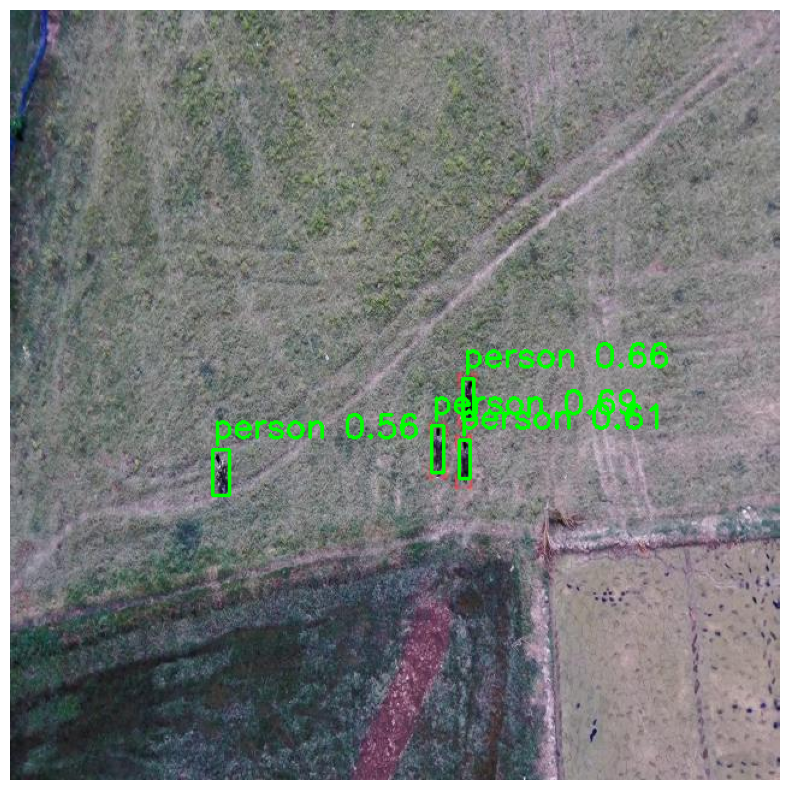


image 1/1 /content/dataset/26-08-2024/test/images/fsi166_jpg.rf.581d80bd59a76204ed3333d66df022f8.jpg: 640x640 3 persons, 11.8ms
Speed: 2.3ms preprocess, 11.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi166_jpg.rf.581d80bd59a76204ed3333d66df022f8.jpg


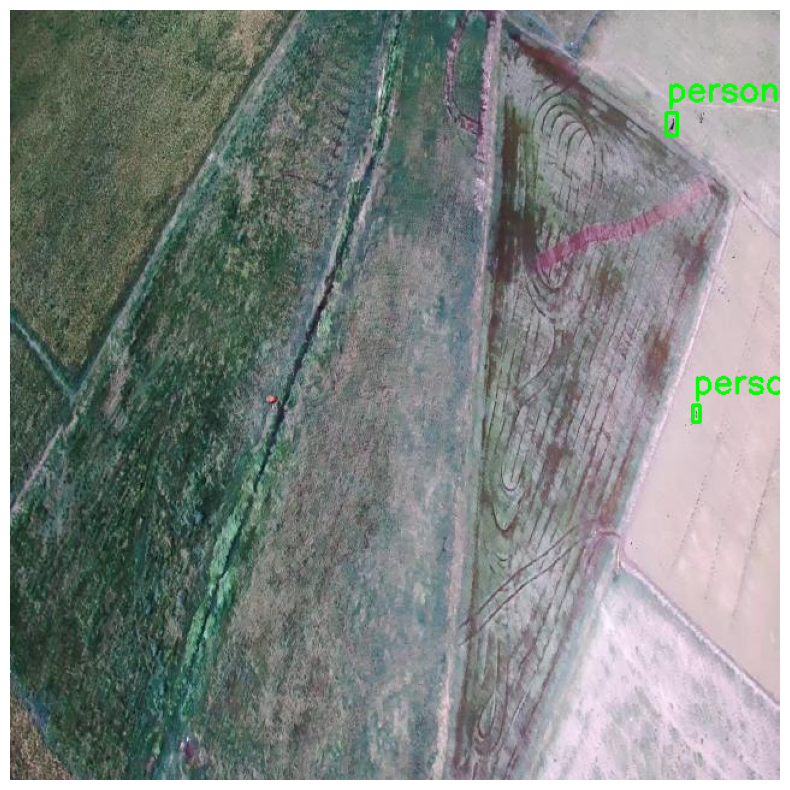


image 1/1 /content/dataset/26-08-2024/test/images/fsi202_jpg.rf.b16b4c9037fa94194bb25445c43285e5.jpg: 640x640 6 persons, 12.5ms
Speed: 2.2ms preprocess, 12.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi202_jpg.rf.b16b4c9037fa94194bb25445c43285e5.jpg


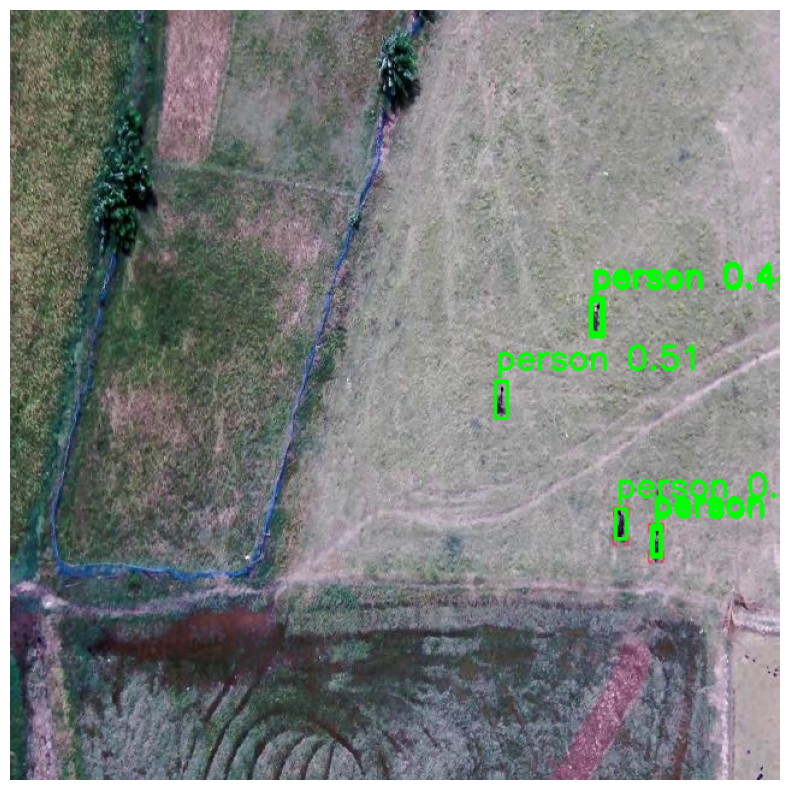


image 1/1 /content/dataset/26-08-2024/test/images/fsi31_jpg.rf.24f066f00746b741db1d2c569c2beeb1.jpg: 640x640 2 persons, 16.5ms
Speed: 2.8ms preprocess, 16.5ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi31_jpg.rf.24f066f00746b741db1d2c569c2beeb1.jpg


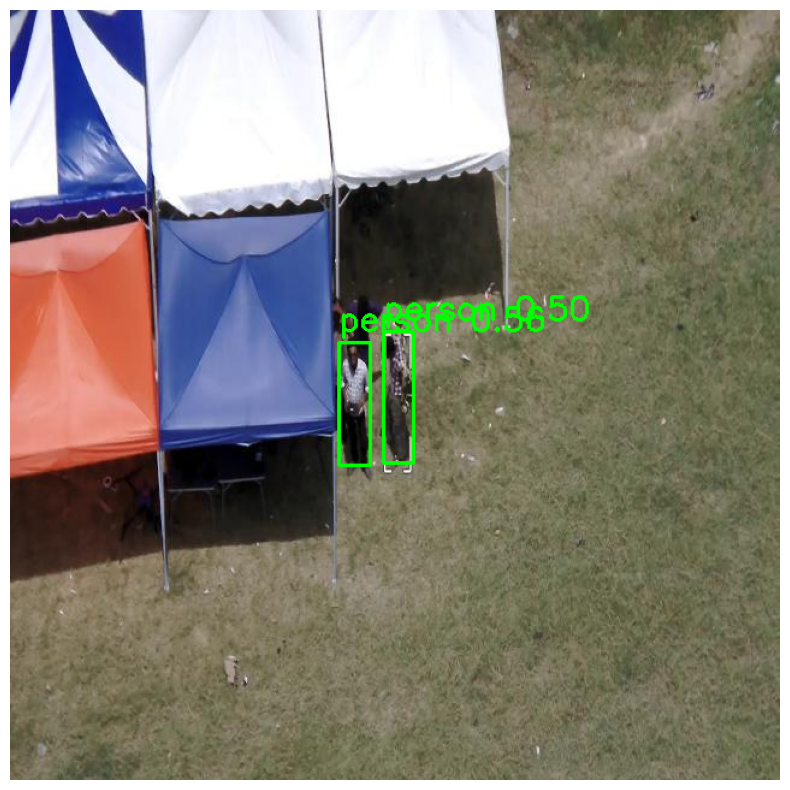


image 1/1 /content/dataset/26-08-2024/test/images/fsi312_jpg.rf.9a4db31cd91e26cfd8be9769256fb6f6.jpg: 640x640 4 persons, 8.6ms
Speed: 2.2ms preprocess, 8.6ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi312_jpg.rf.9a4db31cd91e26cfd8be9769256fb6f6.jpg


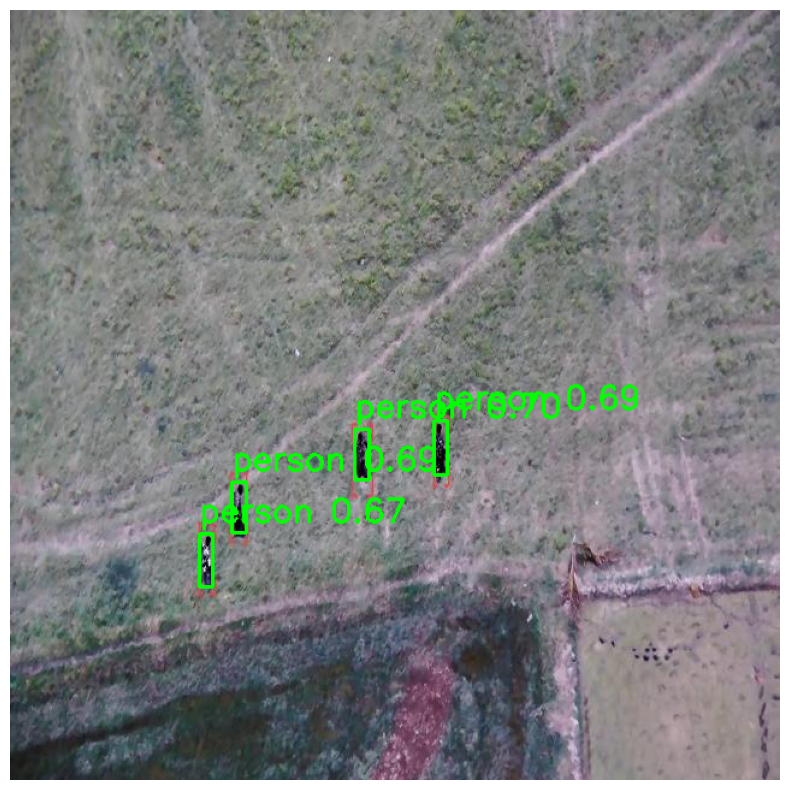


image 1/1 /content/dataset/26-08-2024/test/images/fsi204_jpg.rf.6b04166fa427fa7eef5912c05a68763e.jpg: 640x640 5 persons, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi204_jpg.rf.6b04166fa427fa7eef5912c05a68763e.jpg


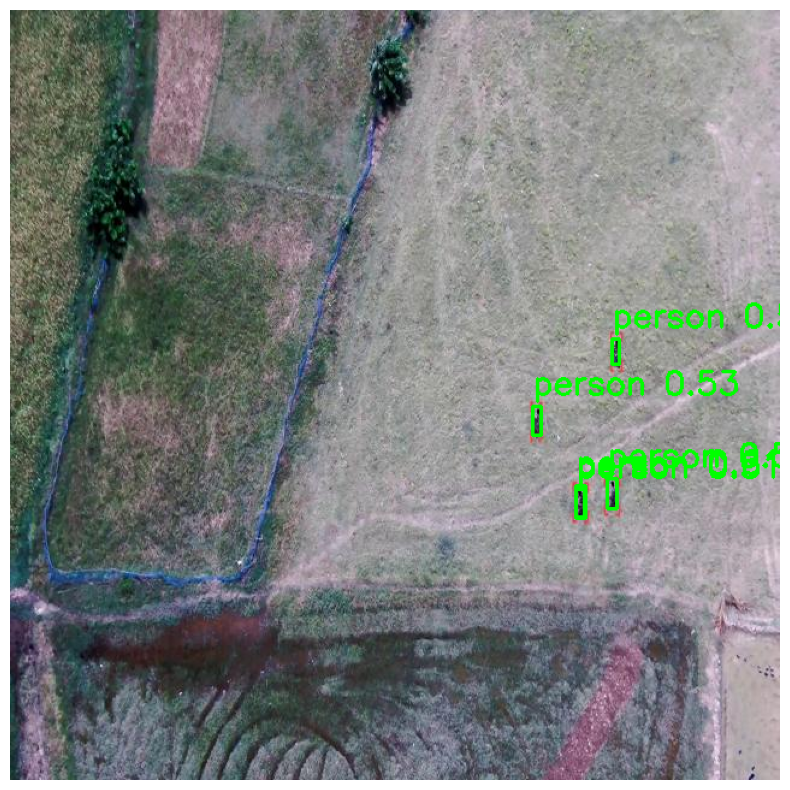


image 1/1 /content/dataset/26-08-2024/test/images/fsi302_jpg.rf.7df03b3e14b5802cda997c63819a35bf.jpg: 640x640 4 persons, 13.6ms
Speed: 4.3ms preprocess, 13.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi302_jpg.rf.7df03b3e14b5802cda997c63819a35bf.jpg


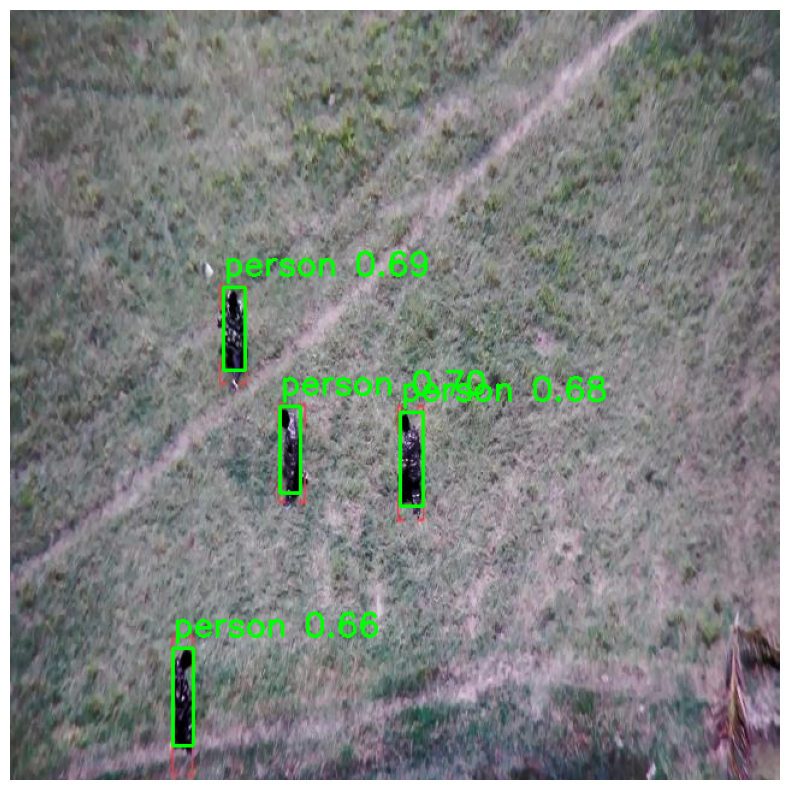


image 1/1 /content/dataset/26-08-2024/test/images/fsi233_jpg.rf.9485af698e1fc9de87fcb7b1eb8310a3.jpg: 640x640 4 persons, 13.1ms
Speed: 2.1ms preprocess, 13.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi233_jpg.rf.9485af698e1fc9de87fcb7b1eb8310a3.jpg


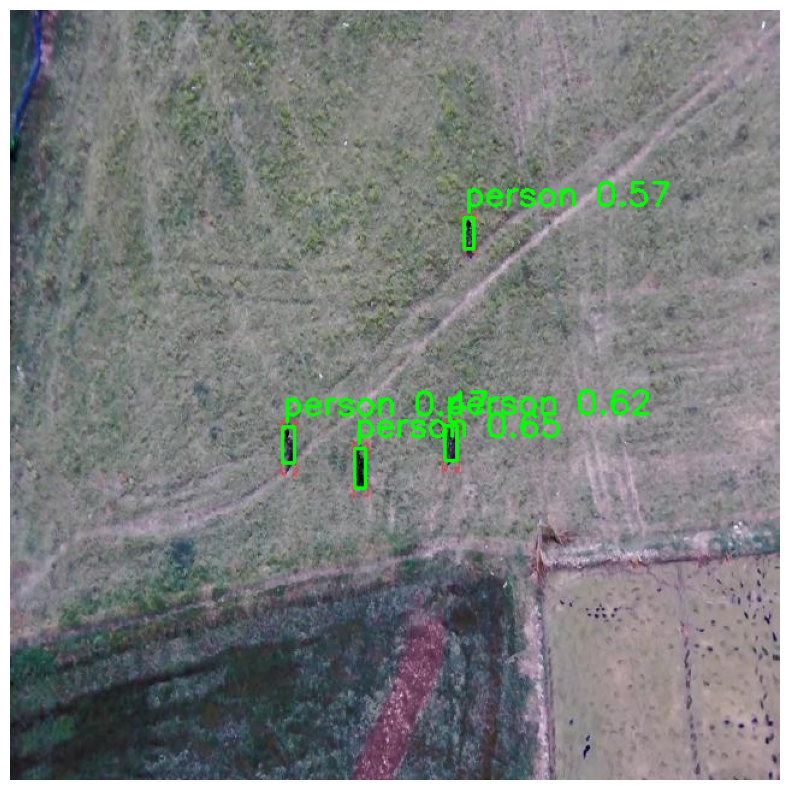


image 1/1 /content/dataset/26-08-2024/test/images/fsi122_jpg.rf.522dadebf50d11555d7317bd3f870330.jpg: 640x640 2 persons, 11.8ms
Speed: 2.2ms preprocess, 11.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi122_jpg.rf.522dadebf50d11555d7317bd3f870330.jpg


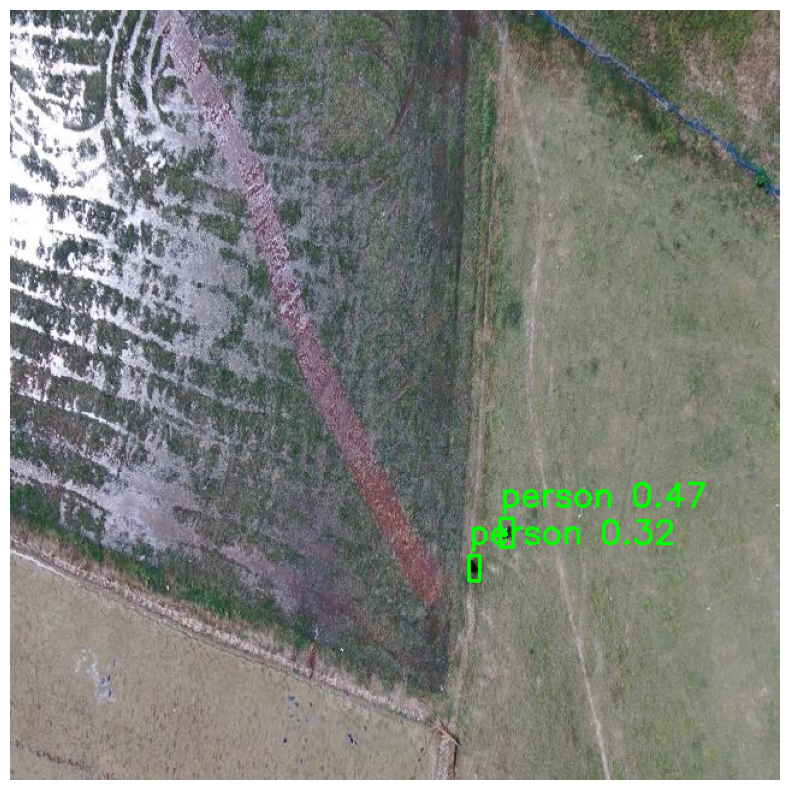


image 1/1 /content/dataset/26-08-2024/test/images/fsi239_jpg.rf.c1e4471b6bce6b74978a9b6e4981db26.jpg: 640x640 5 persons, 10.3ms
Speed: 2.2ms preprocess, 10.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi239_jpg.rf.c1e4471b6bce6b74978a9b6e4981db26.jpg


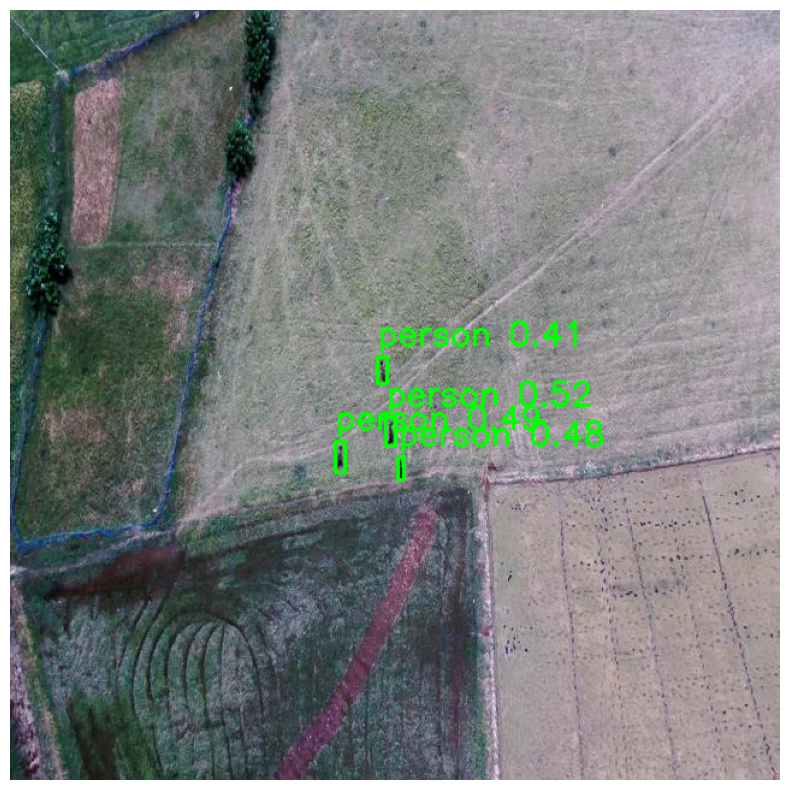


image 1/1 /content/dataset/26-08-2024/test/images/fsi123_jpg.rf.b69a67e450795b785546ce5b8f530b14.jpg: 640x640 1 person, 11.8ms
Speed: 2.3ms preprocess, 11.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi123_jpg.rf.b69a67e450795b785546ce5b8f530b14.jpg


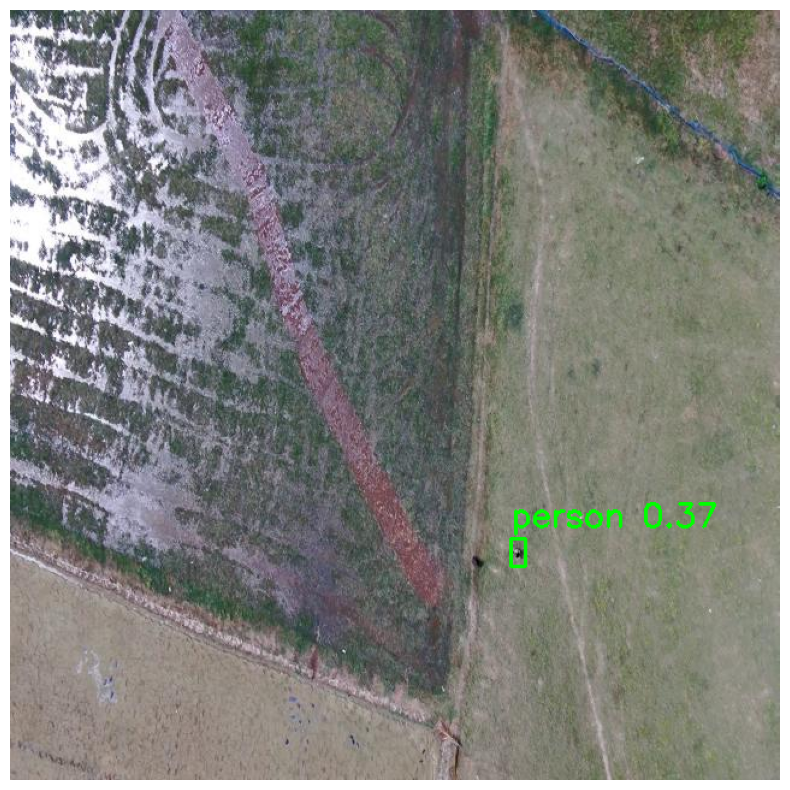


image 1/1 /content/dataset/26-08-2024/test/images/fsi168_jpg.rf.35c2edaef6a21f4a24d5fb8178005a38.jpg: 640x640 2 persons, 9.5ms
Speed: 2.3ms preprocess, 9.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi168_jpg.rf.35c2edaef6a21f4a24d5fb8178005a38.jpg


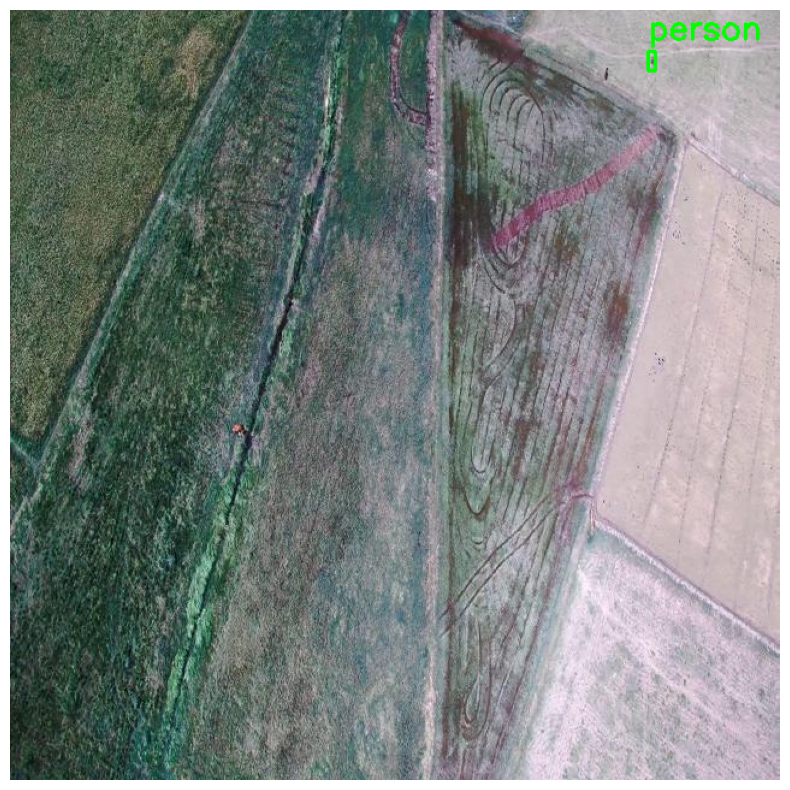


image 1/1 /content/dataset/26-08-2024/test/images/fsi199_jpg.rf.116a692dda56d6bc3bed145beaf5fcf2.jpg: 640x640 4 persons, 15.6ms
Speed: 2.6ms preprocess, 15.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi199_jpg.rf.116a692dda56d6bc3bed145beaf5fcf2.jpg


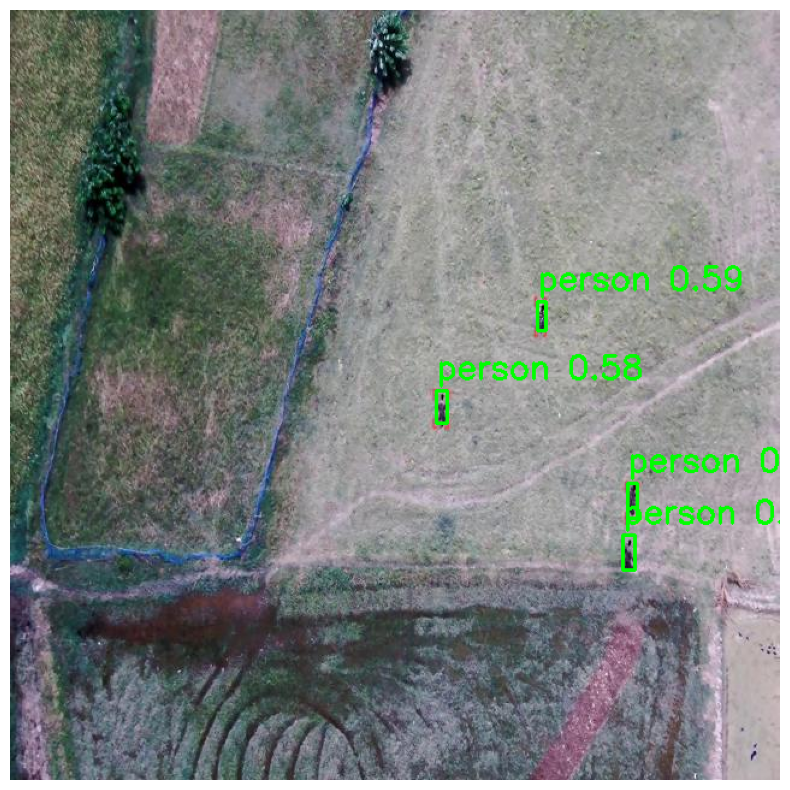


image 1/1 /content/dataset/26-08-2024/test/images/fsi185_jpg.rf.1c7f4e49916e0148adbd96b411ecf321.jpg: 640x640 5 persons, 8.5ms
Speed: 2.3ms preprocess, 8.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Saved annotated image: /content/output/fsi185_jpg.rf.1c7f4e49916e0148adbd96b411ecf321.jpg


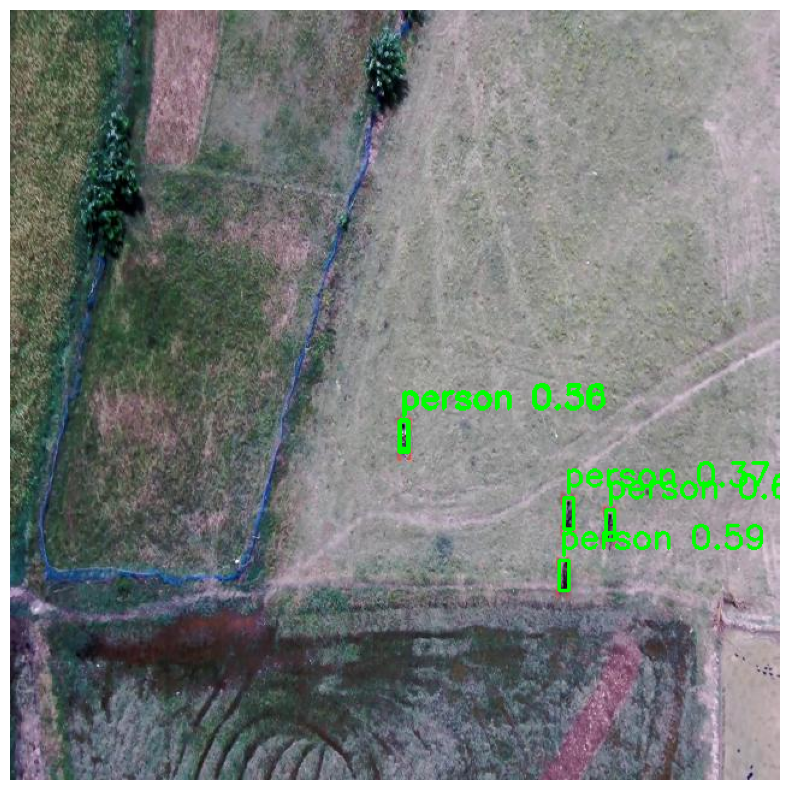

In [9]:
from ultralytics import YOLO
import cv2
import os
import matplotlib.pyplot as plt

# Paths
model_path = r'/content/runs/detect/train/weights/best.pt'
input_folder = r'/content/dataset/26-08-2024/test/images'
output_folder = r'/content/output'

# Create output folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load the trained model
model = YOLO(model_path)

# Iterate through images in the input folder
for image_name in os.listdir(input_folder):
    if image_name.lower().endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(input_folder, image_name)
        image = cv2.imread(image_path)

        # Perform inference
        results = model.predict(source=image_path)

        # Process results
        annotated_image = False  # Flag to track if any person was detected

        for result in results:
            boxes = result.boxes
            names = result.names

            if boxes is not None:
                for box in boxes:
                    x1, y1, x2, y2 = box.xyxy[0].tolist()  # Get bounding box coordinates
                    cls = int(box.cls[0])  # Get class index
                    conf = box.conf[0]  # Get confidence score
                    label = names[cls]

                    if label == 'person' and conf >= 0.3:  # Check if detected object is a person with a confidence score above a threshold
                        annotated_image = True  # Set the flag to True if a person is detected

                        # Draw bounding boxes and labels
                        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                        cv2.putText(image, f'{label} {conf:.2f}', (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

        if annotated_image:
            # Save the annotated image if any persons were detected
            output_image_path = os.path.join(output_folder, image_name)
            cv2.imwrite(output_image_path, image)
            print(f'Saved annotated image: {output_image_path}')

            # Convert BGR to RGB for displaying with matplotlib
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Display the image using matplotlib
            plt.figure(figsize=(10, 10))
            plt.imshow(image_rgb)
            plt.axis('off')
            plt.show()
        else:
            # Optionally delete the image from the input folder if no persons were detected
            os.remove(image_path)
            print(f'No persons detected, deleted image: {image_path}')


# **Live Cam or Video input**

In [20]:
from ultralytics import YOLO
import cv2
import os

# Paths
model_path = r'/content/runs/detect/train/weights/best.pt'
output_folder = r'/content/output'
output_video_path = os.path.join(output_folder, 'annotated_output.mp4')

# Create output folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load the trained model
model = YOLO(model_path)

# Select input source
# Uncomment the source you want to use:

# For live camera input:
# video_source = 0  # Default camera

# For recorded video input:
video_source = r'/content/Video00002.mp4'

# For live camera feed from a drone using IP:
# video_source = 'http://192.168.0.101:8080/video'  # Replace with your drone's IP camera URL

# Open video capture
cap = cv2.VideoCapture(video_source)

# Check if the video source opened successfully
if not cap.isOpened():
    print(f"Error: Could not open video source {video_source}")
    exit()

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Initialize VideoWriter
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for MP4
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

frame_number = 0
while True:
    ret, frame = cap.read()

    if not ret:
        print("End of video stream or failed to capture frame.")
        break

    # Perform inference
    results = model.predict(source=frame)

    # Process results
    annotated_frame = False  # Flag to track if any person was detected

    for result in results:
        boxes = result.boxes
        names = result.names

        if boxes is not None:
            for box in boxes:
                x1, y1, x2, y2 = box.xyxy[0].tolist()  # Get bounding box coordinates
                cls = int(box.cls[0])  # Get class index
                conf = box.conf[0]  # Get confidence score
                label = names[cls]

                if label == 'person' and conf >= 0.3:  # Check if detected object is a person with a confidence score above a threshold
                    annotated_frame = True  # Set the flag to True if a person is detected

                    # Draw bounding boxes and labels
                    cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                    cv2.putText(frame, f'{label} {conf:.2f}', (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

    if annotated_frame:
        # Write the annotated frame to the video file
        out.write(frame)

    # Display the frame (optional)
    # cv2.imshow('YOLO Detection', frame)

    # Press 'q' to quit the video loop
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    frame_number += 1

# Release the video capture and writer objects
cap.release()
out.release()
cv2.destroyAllWindows()

print(f'Annotated video saved at: {output_video_path}')


Streaming output truncated to the last 5000 lines.

0: 384x640 6 persons, 7.6ms
Speed: 3.2ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 7.4ms
Speed: 3.1ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 6 persons, 7.1ms
Speed: 3.3ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 6 persons, 7.2ms
Speed: 3.1ms preprocess, 7.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 9.3ms
Speed: 3.1ms preprocess, 9.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 11.1ms
Speed: 3.0ms preprocess, 11.1ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 11.8ms
Speed: 4.9ms preprocess, 11.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 11.5ms
Speed: 3.5ms preprocess, 11.5ms inferenc

# **Downlord the output**

In [17]:
import zipfile
import os

def zip_directory(folder_path, output_path):
    with zipfile.ZipFile(output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                arcname = os.path.relpath(file_path, folder_path)
                zipf.write(file_path, arcname)

# Path to the folder you want to zip
folder_to_zip = '/content/output'
# Path where you want to save the zip file
zip_file_path = '/content/results.zip'

zip_directory(folder_to_zip, zip_file_path)